In [2]:
import pandas as pd
import geopandas as gpd
import osmnx as ox
import folium
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
place = "röthenbach an der pegnitz, Germany"
#place = "erlangen, Germany"
graph = ox.graph_from_place(place)

/opt/anaconda3/lib/python3.8/site-packages/osmnx/geocoder.py:110: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(_geocode_query_to_gdf(q, wr, by_osmid))


In [4]:
nodes, streets = ox.graph_to_gdfs(graph)
streets.head(),nodes.head()

(                            osmid        name       highway maxspeed  \
 u        v         key                                                 
 31456119 31469074  0      4873821  Moritzberg  unclassified       50   
          339388819 0    145799848         NaN          path      NaN   
          31456120  0    175057391  Moritzberg       service       50   
          390528624 0    439394246  Moritzberg       service       50   
 31456120 414019024 0     37698902         NaN          path      NaN   
 
                              access  oneway   length  \
 u        v         key                                 
 31456119 31469074  0    destination   False   26.638   
          339388819 0            NaN   False   64.452   
          31456120  0    destination   False   54.462   
          390528624 0            NaN   False   47.268   
 31456120 414019024 0            NaN   False  145.275   
 
                                                                  geometry  \
 u      

In [5]:
street_types = pd.DataFrame(streets["highway"].apply(pd.Series)[0].value_counts().reset_index())
street_types.columns = ["type", "count"]
street_types


,type,count
0,residential,1164
1,service,1086
2,path,547
3,footway,522
4,track,354
5,secondary,231
6,living_street,127
7,unclassified,86
8,tertiary,56
9,pedestrian,8


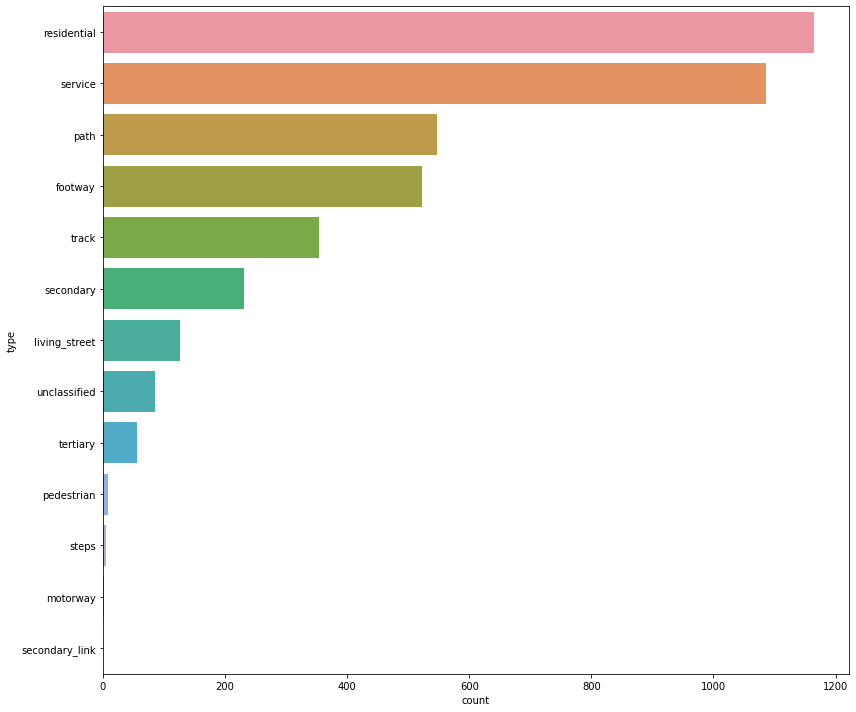

In [6]:
fig, ax = plt.subplots(figsize=(12,10))
sns.barplot(y="type", x="count", data=street_types, ax=ax)
plt.tight_layout()
plt.savefig("barchart.png")

In [7]:
tags = {"building": True}
buildings = ox.geometries_from_place(place,tags)
fire_stations = buildings[buildings.amenity == "fire_station"]
#fire_stations = ox.geometries_from_address(place, tags={"amenity": "fire_station"}, dist=5000)


/opt/anaconda3/lib/python3.8/site-packages/osmnx/geocoder.py:110: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(_geocode_query_to_gdf(q, wr, by_osmid))


In [8]:

args = [buildings, streets,fire_stations]
m = folium.Map(location=[49.4521, 11.0767], zoom_start=10,tiles="CartoDb dark_matter", control_scale=True)
styles = [{'color': '#F7DC6F', 'weight':'1'},{'color': '#00FF00', 'weight':'2'},{'color': '#FF0000', 'weight':'2'},{'color': '#FF0000', 'weight':'2'}]
def add_layers(m, style, arg):
    folium.features.GeoJson(arg, style_function = lambda x: style).add_to(m)

for i,arg in enumerate(args):
    s = styles[i]
    add_layers(m,s, arg)

folium.LayerControl().add_to(m)   
#map.save('{}.html'.format("map")) 

In [9]:
m

In [10]:
m = folium.Map(location=[49.4521, 11.0767], zoom_start=10, tiles="CartoDb dark_matter",control_scale=True)
#folium.features.GeoJson(streets).add_to(m)
#folium.LayerControl().add_to(m)
style = [{'color': '#F7DC6F', 'weight':'1'},{'color': '#00FF00', 'weight':'2'},{'color': '#FF0000', 'weight':'2'},{'color': '#FF0000', 'weight':'2'}]
folium.features.GeoJson(buildings, name = 'buidlings', style_function=lambda x: style[0]).add_to(m)
folium.features.GeoJson(streets,name = 'steerts', style_function=lambda x: style[1]).add_to(m)
folium.features.GeoJson(fire_stations,name = "Fire Stations",style_function=lambda x: style[2]).add_to(m)
folium.LayerControl().add_to(m)


## drawing the isochrones of

In [11]:
import openrouteservice
key='5b3ce3597851110001cf624864c7b4d77462447c9035fc94c899056e'
coords = ((8.34234,48.23424),(8.34423,48.26424))

client = openrouteservice.Client(key=key)


In [12]:
streets.crs # edges

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [13]:
streets.head()

osmid        name       highway maxspeed  \
u        v         key                                                 
31456119 31469074  0      4873821  Moritzberg  unclassified       50   
         339388819 0    145799848         NaN          path      NaN   
         31456120  0    175057391  Moritzberg       service       50   
         390528624 0    439394246  Moritzberg       service       50   
31456120 414019024 0     37698902         NaN          path      NaN   

                             access  oneway   length  \
u        v         key                                 
31456119 31469074  0    destination   False   26.638   
         339388819 0            NaN   False   64.452   
         31456120  0    destination   False   54.462   
         390528624 0            NaN   False   47.268   
31456120 414019024 0            NaN   False  145.275   

                                                                 geometry  \
u        v         key                                                      
31456119 31469074  0    LINESTRING (11.31224 49.46724, 11.31219 49.467...   
         339388819 0    LINESTRING (11.31224 49.46724, 11.31250 49.467...   
         31456120  0    LINESTRING (11.31224 49.46724, 11.31239 49.467...   
         390528624 0    LINESTRING (11.31224 49.46724, 11.31232 49.467...   
31456120 414019024 0    LINESTRING (11.31256 49.46681, 11.31249 49.466...   

                       width   service  ref lanes bridge tunnel est_width  \
u        v         key                                                      
31456119 31469074  0     NaN       NaN  NaN   NaN    NaN    NaN       NaN   
         339388819 0     0.8       NaN  NaN   NaN    NaN    NaN       NaN   
         31456120  0     NaN       NaN  NaN   NaN    NaN    NaN       NaN   
         390528624 0     NaN  driveway  NaN   NaN    NaN    NaN       NaN   
31456120 414019024 0     NaN       NaN  NaN   NaN    NaN    NaN       NaN   

                       junction  
u        v         key           
31456119 31469074  0        NaN  
         339388819 0        NaN  
         31456120  0        NaN  
         390528624 0        NaN  
31456120 414019024 0        NaN

In [14]:
# Project the data
graph_proj = ox.project_graph(graph) 

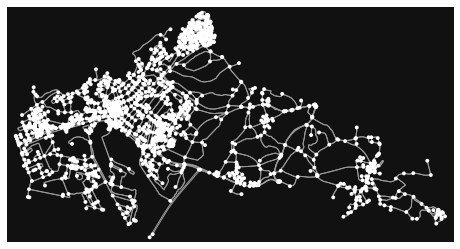

In [15]:
fig, ax = ox.plot_graph(graph)

In [16]:
# Retrieve only edges from the graph
edges = ox.graph_to_gdfs(graph, nodes=False, edges=True)

In [17]:
# Check columns
edges.columns

Index(['osmid', 'name', 'highway', 'maxspeed', 'access', 'oneway', 'length',
       'geometry', 'width', 'service', 'ref', 'lanes', 'bridge', 'tunnel',
       'est_width', 'junction'],
      dtype='object')

In [18]:
# Check crs
edges.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [19]:
edges.head()

osmid        name       highway maxspeed  \
u        v         key                                                 
31456119 31469074  0      4873821  Moritzberg  unclassified       50   
         339388819 0    145799848         NaN          path      NaN   
         31456120  0    175057391  Moritzberg       service       50   
         390528624 0    439394246  Moritzberg       service       50   
31456120 414019024 0     37698902         NaN          path      NaN   

                             access  oneway   length  \
u        v         key                                 
31456119 31469074  0    destination   False   26.638   
         339388819 0            NaN   False   64.452   
         31456120  0    destination   False   54.462   
         390528624 0            NaN   False   47.268   
31456120 414019024 0            NaN   False  145.275   

                                                                 geometry  \
u        v         key                                                      
31456119 31469074  0    LINESTRING (11.31224 49.46724, 11.31219 49.467...   
         339388819 0    LINESTRING (11.31224 49.46724, 11.31250 49.467...   
         31456120  0    LINESTRING (11.31224 49.46724, 11.31239 49.467...   
         390528624 0    LINESTRING (11.31224 49.46724, 11.31232 49.467...   
31456120 414019024 0    LINESTRING (11.31256 49.46681, 11.31249 49.466...   

                       width   service  ref lanes bridge tunnel est_width  \
u        v         key                                                      
31456119 31469074  0     NaN       NaN  NaN   NaN    NaN    NaN       NaN   
         339388819 0     0.8       NaN  NaN   NaN    NaN    NaN       NaN   
         31456120  0     NaN       NaN  NaN   NaN    NaN    NaN       NaN   
         390528624 0     NaN  driveway  NaN   NaN    NaN    NaN       NaN   
31456120 414019024 0     NaN       NaN  NaN   NaN    NaN    NaN       NaN   

                       junction  
u        v         key           
31456119 31469074  0        NaN  
         339388819 0        NaN  
         31456120  0        NaN  
         390528624 0        NaN  
31456120 414019024 0        NaN

In [20]:
# Get Edges and Nodes
nodes_proj, edges_proj = ox.graph_to_gdfs(graph_proj, nodes=True, edges=True)

In [21]:
nodes_proj.head()

,y,x,street_count,lon,lat,highway,ref,geometry
osmid,,,,,,,,
31456119,5.481969e+06,667528.109805,4,11.312236,49.467245,NaN,NaN,POINT (667528.110 5481969.154)
31469074,5.481957e+06,667504.477407,3,11.311905,49.467141,NaN,NaN,POINT (667504.477 5481956.857)
339388819,5.481992e+06,667573.461074,3,11.312871,49.467436,NaN,NaN,POINT (667573.461 5481991.819)
31456120,5.481921e+06,667552.771725,3,11.312556,49.466809,NaN,NaN,POINT (667552.772 5481921.443)
390528624,5.481997e+06,667507.114633,4,11.311958,49.467500,NaN,NaN,POINT (667507.115 5481996.871)


In [22]:
print("Coordinate system:", edges_proj.crs)

Coordinate system: +proj=utm +zone=32 +ellps=WGS84 +datum=WGS84 +units=m +no_defs +type=crs


In [23]:
edges_proj.head()

osmid        name       highway maxspeed  \
u        v         key                                                 
31456119 31469074  0      4873821  Moritzberg  unclassified       50   
         339388819 0    145799848         NaN          path      NaN   
         31456120  0    175057391  Moritzberg       service       50   
         390528624 0    439394246  Moritzberg       service       50   
31469074 307815582 0     28033106         NaN         track      NaN   

                             access  oneway  length  \
u        v         key                                
31456119 31469074  0    destination   False  26.638   
         339388819 0            NaN   False  64.452   
         31456120  0    destination   False  54.462   
         390528624 0            NaN   False  47.268   
31469074 307815582 0            NaN   False  21.837   

                                                                 geometry  \
u        v         key                                                      
31456119 31469074  0    LINESTRING (667528.110 5481969.154, 667524.476...   
         339388819 0    LINESTRING (667528.110 5481969.154, 667547.377...   
         31456120  0    LINESTRING (667528.110 5481969.154, 667539.404...   
         390528624 0    LINESTRING (667528.110 5481969.154, 667534.203...   
31469074 307815582 0    LINESTRING (667504.477 5481956.857, 667484.412...   

                       width   service  ref lanes bridge est_width tunnel  \
u        v         key                                                      
31456119 31469074  0     NaN       NaN  NaN   NaN    NaN       NaN    NaN   
         339388819 0     0.8       NaN  NaN   NaN    NaN       NaN    NaN   
         31456120  0     NaN       NaN  NaN   NaN    NaN       NaN    NaN   
         390528624 0     NaN  driveway  NaN   NaN    NaN       NaN    NaN   
31469074 307815582 0     NaN       NaN  NaN   NaN    NaN       NaN    NaN   

                       junction  
u        v         key           
31456119 31469074  0        NaN  
         339388819 0        NaN  
         31456120  0        NaN  
         390528624 0        NaN  
31469074 307815582 0        NaN

In [75]:
a =fire_stations["geometry"].centroid.values[0]

/var/folders/wt/9gf59rdd2j16lhgptjnc2cxh0000gp/T/ipykernel_86415/1207462835.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  a =fire_stations["geometry"].centroid.values[0]


public_places:
    id: 360
    children:
        amenity:
            embassy: 361
            crematorium: 362
            community_centre: 363
            courthouse: 364
            coworking_space: 365
            crypt: 366
            fire_station: 367
            grave_yard: 368
            police: 369
            post_office: 370
            prison: 371
            ranger_station: 372
            rescue_station: 373
            townhall: 374

In [76]:
a =fire_stations["geometry"]


list of coordinates for firestations

In [90]:
fire_station = list(a.exterior.iloc[0].coords)[1]

In [89]:
fire_station

[(11.296579, 49.4724911),
 (11.2967908, 49.4724679),
 (11.2967638, 49.4723638),
 (11.296552, 49.472387),
 (11.296579, 49.4724911)]

In [91]:
geocoded_place = ox.geocode_to_gdf(place)

/opt/anaconda3/lib/python3.8/site-packages/osmnx/geocoder.py:110: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(_geocode_query_to_gdf(q, wr, by_osmid))


In [92]:
lat,lon = geocoded_place.lat[0],geocoded_place.lon[0]
lon, lat = fire_station[0], fire_station[1]   

In [93]:
# coordinates
coordinates = [[11.016667,49.583332,]]
coordinates = [[lon, lat]]

# isochrone
isochrone = client.isochrones(locations=coordinates,
                              range_type='time',
                              # 900 seconds, 15 minutes
                              range=[300,600,900])

In [94]:
# map
map_isochrone = folium.Map(location=[lat,lon], tiles='cartodbpositron', zoom_start=12)

# add geojson to map with population
#population = isochrone['features'][0]['properties']['total_pop']
folium.GeoJson(isochrone, name='isochrone').add_to(map_isochrone)

# add marker to map
minutes = isochrone['features'][0]['properties']['value']/60
popup_message = f'outline shows areas reachable within {minutes} minutes'
folium.Marker([lat, lon], popup=popup_message, tooltip='click').add_to(m)

# add layer control to map (allows layer to be turned on or off)
folium.LayerControl().add_to(map_isochrone)

# display map
map_isochrone



In [95]:
map_isochrone_street= folium.Map(location=[lat, lon], tiles='cartodbpositron', zoom_start=12)

# add geojson to map with population
#population = isochrone['features'][0]['properties']['total_pop']
folium.GeoJson(isochrone, name='isochrone').add_to(map_isochrone_street)

style = [{'color': '#F7DC6F', 'weight':'1'},{'color': '#00FF00', 'weight':'2'},{'color': '#FF0000', 'weight':'2'},{'color': '#FF0000', 'weight':'2'}]
folium.features.GeoJson(buildings, name = 'buidlings', style_function=lambda x: style[0]).add_to(map_isochrone_street)
folium.features.GeoJson(streets,name = 'steerts', style_function=lambda x: style[1]).add_to(map_isochrone_street)
folium.features.GeoJson(fire_stations,name = "Fire Stations",style_function=lambda x: style[2]).add_to(map_isochrone_street)
# add marker to map
minutes = isochrone['features'][0]['properties']['value']/60
popup_message = f'outline shows areas reachable within {minutes} minutes'
folium.Marker([25.784097, -80.127995], popup=popup_message, tooltip='click').add_to(map_isochrone_street)

# add layer control to map (allows layer to be turned on or off)
folium.LayerControl().add_to(map_isochrone_street)

# display map
map_isochrone_street


